# Выбор порога
## Описание экспериментов
Данный блокнот сделан с целью выбора порога для относительной точности ($\frac{\|x_k\|_2^2}{\|x_0\|_2^2}$) в градиентном спуске (параметр tolerance). Данный параметр будет отбираться по логарифмической шкале от 1 до $10^{-8}$. Методы выбора длины шага будут следующие:
- Константный выбор $\alpha = 10^{-8}$
- Выбор по формуле $\alpha_k = \lambda \left( \frac{s_0}{s_0 + k} \right)^p$, где $\lambda = 2 * 10^{-8}$, $s_0 = 1$, $p=0.5$.
- Линейный поиск $\alpha$, удовлетворяющего условиям Армихо (стартовый $\alpha = 10^{-7}$)
- Линейный поиск $\alpha$, удовлетворяющего условиям Вульфа (стартовый $\alpha = 10^{-7}$)

Я возьму 15 рядов разной сезонности из датасета M4 и изображу графики зависимости функции потерь от порога и доли несошедшихся оптимизаций (на этих рядах) от порога для каждого метода отдельно (sns.relplot по рядам), для обычной динамической регрессии и для сезонной.

Параметры для динамических регрессий будут браться следующие:
- Для обычной --  `fh=[5]`, `sp=None`, `learning_steps='all'`, `ar_depth=5`, `seas_depth=2`, `fit_intercept=True`, `max_iter=100`, `tolerance=1e-5`.
- Для сезонной -- `fh=[5]`, `learning_steps='all'`, `ar_depth=5`, `seas_depth=2`, `fit_intercept=True`, `max_iter=100`, `tolerance=1e-5`, а параметр `sp` будет зависеть от сезонности ряда -- для часовых `sp=24`, для дневных `sp=30`, для недельных `sp=4`, для квартальных `sp=4`, для месячных `sp=12`, для годовых `sp=10`.

Для каждого метода отдельно будут тестироваться следующие гипотезы:
- (DLS) Самый эффективный порог -- (1|...|$10^{-8}$) (самый большой из подходящих), критерием для этого является боковой тренд функции потерь при дальнейшем оптимизации (после получения этого порога).
- (DLS) Самый надёжный порог -- (1|...|$10^{-8}$) (самый маленький из подходящих), критерием для этого является отсутствие несошедшихся рядов.
- (DLS) Лучший по эффективности порог больше лучшего по надёжности.
- (SDLS) Самый эффективный порог -- (1|...|$10^{-8}$), критерием для этого является боковой тренд функции потерь при дальнейшем оптимизации (после получения этого порога).
- (SDLS) Самый надёжный порог -- (1|...|$10^{-8}$) (самый маленький из подходящих), критерием для этого является отсутствие несошедшихся рядов.
- (SDLS) Лучший по эффективности порог больше лучшего по надёжности.
- Отрезки [эффективный, надёжный] для DLS и SDLS пересекаются.

## Эксперименты

Импортируем нужные библиотеки:

In [3]:
import pandas as pd
import numpy as np
from sktime.forecasting.model_selection import temporal_train_test_split
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
plt.rcParams['figure.figsize'] = 8, 5
plt.rcParams['font.size'] = 12
mpl.rcParams['savefig.format'] = 'pdf'
sns.set(style="darkgrid")

import sys
import os

module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

from models.dynamic_regression import DynamicRegression
from models.models import SktimeETS, SktimeARIMA, SktimeLinearRegression

Формируем датасет:

In [4]:
columns = ["H1", "H200", "D1", "D3", "W1", "W2", "M1", "M10", "M100", "Q1", "Q10", "Q100", "Y1", "Y10", "Y100"]
dataset = pd.DataFrame(columns=columns)
for column in columns:
    if column.startswith("H"):
        cur_dataset = pd.read_csv("/Users/beast-sl/source/repos/coursework-3/Dataset/Train/Hourly-train.csv")
    elif column.startswith("D"):
        cur_dataset = pd.read_csv("/Users/beast-sl/source/repos/coursework-3/Dataset/Train/Daily-train.csv")
    elif column.startswith("W"):
        cur_dataset = pd.read_csv("/Users/beast-sl/source/repos/coursework-3/Dataset/Train/Weekly-train.csv")
    elif column.startswith("M"):
        cur_dataset = pd.read_csv("/Users/beast-sl/source/repos/coursework-3/Dataset/Train/Monthly-train.csv")
    elif column.startswith("Q"):
        cur_dataset = pd.read_csv("/Users/beast-sl/source/repos/coursework-3/Dataset/Train/Quarterly-train.csv")
    elif column.startswith("Y"):
        cur_dataset = pd.read_csv("/Users/beast-sl/source/repos/coursework-3/Dataset/Train/Yearly-train.csv")
    series = cur_dataset[cur_dataset["V1"] == column].squeeze().dropna().drop(index='V1').astype(np.float64)
    series.index = range(len(series))
    series = series.reindex(range(2179))
    dataset[column] = series
dataset

,H1,H200,D1,D3,W1,W2,M1,M10,M100,Q1,Q10,Q100,Y1,Y10,Y100
0,605.0,12.2,1017.1,1091.3,1089.20,195.928,8000.0,16960.0,1000.0,7407.412314,2329.0,5036.0,5172.1,1972.008,7234.531669
1,586.0,11.5,1019.3,1088.5,1078.91,194.796,8350.0,17170.0,1020.6,7528.566074,2349.9,5089.0,5133.5,1997.897,7429.999414
2,586.0,11.1,1017.0,1085.7,1079.88,192.710,8570.0,17420.0,1017.0,7374.709225,2332.9,5226.0,5186.9,2016.821,7616.196582
3,559.0,10.7,1019.2,1082.9,1063.58,190.288,7700.0,17680.0,1011.0,7395.514848,2381.5,5328.0,5084.6,2030.903,7379.222933
4,511.0,10.3,1018.7,1080.1,1060.61,188.770,7080.0,17670.0,997.8,7654.007989,2382.6,5009.0,5182.0,2047.455,7675.008715
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2174,NaN,NaN,NaN,NaN,38429.93,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2175,NaN,NaN,NaN,NaN,38429.93,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2176,NaN,NaN,NaN,NaN,36565.18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2177,NaN,NaN,NaN,NaN,36565.18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Метод 1. Константный

#### DLS

In [3]:
plt.figure(figsize=(8, 5))
methods = ['Constant', 'Formula', 'Armijo', 'Wolfe']
tolerances = np.logspace(0, -8, num=9)
df_func = pd.DataFrame(columns=['Method', 'Tolerance', 'Func'])
df_conv_fail = pd.DataFrame(columns=['Method', 'Tolerance', 'Failures perc'])
df_comp_fail = pd.DataFrame(columns=['Method', 'Tolerance', 'Failures perc'])
for method in methods:
    for tolerance in tolerances:
        conv_failures = 0
        comp_failures = 0
        for col_name in columns:
            print(f"method {method}, tolerance {tolerance}, column {col_name}")
            model = DynamicRegression(fh=5, tolerance=tolerance)
            try:
                status, history = model.fit(dataset[col_name].dropna(), trace=True, lr_finder=method)
                if status == 'iterations_exceeded':
                    conv_failures += 1
                if status == 'computational_error': 
                    comp_failures += 1
                    print(f"WARNING: Computational error on method {method}, tolerance {tolerance}, column {col_name}")
            except:
                print(f"WARNING: Computational error on method {method}, tolerance {tolerance}, column {col_name}")
                comp_failures += 1
            df_func.loc[len(df_func)] = [method, tolerance, history['func'][-1]]
        df_conv_fail.loc[len(df_conv_fail)] = [method, tolerance, conv_failures / len(columns)]
        df_comp_fail.loc[len(df_comp_fail)] = [method, tolerance, comp_failures / len(columns)]
g = sns.relplot(data=df_func, x='Tolerance', y='Func', hue='Method', kind='line', height=5, aspect=1.6)
g.set(xscale="log")
for ax in g.axes:
    ax.invert_xaxis()
g.set(title="Loss function depending on tolerance for different optimization methods")
plt.close('all')

method Constant, tolerance 1.0, column H1
method Constant, tolerance 1.0, column H200
method Constant, tolerance 1.0, column D1
method Constant, tolerance 1.0, column D3
method Constant, tolerance 1.0, column W1
method Constant, tolerance 1.0, column W2
method Constant, tolerance 1.0, column M1
method Constant, tolerance 1.0, column M10
method Constant, tolerance 1.0, column M100
method Constant, tolerance 1.0, column Q1
method Constant, tolerance 1.0, column Q10
method Constant, tolerance 1.0, column Q100
method Constant, tolerance 1.0, column Y1
method Constant, tolerance 1.0, column Y10
method Constant, tolerance 1.0, column Y100
method Constant, tolerance 0.1, column H1
method Constant, tolerance 0.1, column H200
method Constant, tolerance 0.1, column D1
method Constant, tolerance 0.1, column D3
method Constant, tolerance 0.1, column W1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Constant, tolerance 0.1, column W2
method Constant, tolerance 0.1, column M1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: Run

method Constant, tolerance 0.1, column M10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Constant, tolerance 0.1, column M100
method Constant, tolerance 0.1, column Q1
method Constant, tolerance 0.1, column Q10
method Constant, tolerance 0.1, column Q100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Constant, tolerance 0.1, column Y1
method Constant, tolerance 0.1, column Y10
method Constant, tolerance 0.1, column Y100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Constant, tolerance 0.01, column H1
method Constant, tolerance 0.01, column H200
method Constant, tolerance 0.01, column D1
method Constant, tolerance 0.01, column D3
method Constant, tolerance 0.01, column W1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Constant, tolerance 0.01, column W2
method Constant, tolerance 0.01, column M1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarni

method Constant, tolerance 0.01, column M10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Constant, tolerance 0.01, column M100
method Constant, tolerance 0.01, column Q1
method Constant, tolerance 0.01, column Q10
method Constant, tolerance 0.01, column Q100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Constant, tolerance 0.01, column Y1
method Constant, tolerance 0.01, column Y10
method Constant, tolerance 0.01, column Y100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Constant, tolerance 0.001, column H1
method Constant, tolerance 0.001, column H200
method Constant, tolerance 0.001, column D1
method Constant, tolerance 0.001, column D3
method Constant, tolerance 0.001, column W1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Constant, tolerance 0.001, column W2
method Constant, tolerance 0.001, column M1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarni

method Constant, tolerance 0.001, column M10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Constant, tolerance 0.001, column M100
method Constant, tolerance 0.001, column Q1
method Constant, tolerance 0.001, column Q10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Constant, tolerance 0.001, column Q100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Constant, tolerance 0.001, column Y1
method Constant, tolerance 0.001, column Y10
method Constant, tolerance 0.001, column Y100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Constant, tolerance 0.0001, column H1
method Constant, tolerance 0.0001, column H200
method Constant, tolerance 0.0001, column D1
method Constant, tolerance 0.0001, column D3
method Constant, tolerance 0.0001, column W1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Constant, tolerance 0.0001, column W2
method Constant, tolerance 0.0001, column M1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Constant, tolerance 0.0001, column M10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Constant, tolerance 0.0001, column M100
method Constant, tolerance 0.0001, column Q1
method Constant, tolerance 0.0001, column Q10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Constant, tolerance 0.0001, column Q100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Constant, tolerance 0.0001, column Y1
method Constant, tolerance 0.0001, column Y10
method Constant, tolerance 0.0001, column Y100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Constant, tolerance 1e-05, column H1
method Constant, tolerance 1e-05, column H200
method Constant, tolerance 1e-05, column D1
method Constant, tolerance 1e-05, column D3
method Constant, tolerance 1e-05, column W1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Constant, tolerance 1e-05, column W2
method Constant, tolerance 1e-05, column M1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Constant, tolerance 1e-05, column M10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Constant, tolerance 1e-05, column M100
method Constant, tolerance 1e-05, column Q1
method Constant, tolerance 1e-05, column Q10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Constant, tolerance 1e-05, column Q100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Constant, tolerance 1e-05, column Y1
method Constant, tolerance 1e-05, column Y10
method Constant, tolerance 1e-05, column Y100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Constant, tolerance 1e-06, column H1
method Constant, tolerance 1e-06, column H200
method Constant, tolerance 1e-06, column D1
method Constant, tolerance 1e-06, column D3
method Constant, tolerance 1e-06, column W1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Constant, tolerance 1e-06, column W2
method Constant, tolerance 1e-06, column M1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Constant, tolerance 1e-06, column M10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Constant, tolerance 1e-06, column M100
method Constant, tolerance 1e-06, column Q1
method Constant, tolerance 1e-06, column Q10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Constant, tolerance 1e-06, column Q100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarni

method Constant, tolerance 1e-06, column Y1
method Constant, tolerance 1e-06, column Y10
method Constant, tolerance 1e-06, column Y100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarni

method Constant, tolerance 1e-07, column H1
method Constant, tolerance 1e-07, column H200
method Constant, tolerance 1e-07, column D1
method Constant, tolerance 1e-07, column D3
method Constant, tolerance 1e-07, column W1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Constant, tolerance 1e-07, column W2
method Constant, tolerance 1e-07, column M1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Constant, tolerance 1e-07, column M10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Constant, tolerance 1e-07, column M100
method Constant, tolerance 1e-07, column Q1
method Constant, tolerance 1e-07, column Q10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Constant, tolerance 1e-07, column Q100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Constant, tolerance 1e-07, column Y1
method Constant, tolerance 1e-07, column Y10
method Constant, tolerance 1e-07, column Y100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Constant, tolerance 1e-08, column H1
method Constant, tolerance 1e-08, column H200
method Constant, tolerance 1e-08, column D1
method Constant, tolerance 1e-08, column D3
method Constant, tolerance 1e-08, column W1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Constant, tolerance 1e-08, column W2
method Constant, tolerance 1e-08, column M1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Constant, tolerance 1e-08, column M10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Constant, tolerance 1e-08, column M100
method Constant, tolerance 1e-08, column Q1
method Constant, tolerance 1e-08, column Q10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Constant, tolerance 1e-08, column Q100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Constant, tolerance 1e-08, column Y1
method Constant, tolerance 1e-08, column Y10
method Constant, tolerance 1e-08, column Y100
method Formula, tolerance 1.0, column H1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Formula, tolerance 1.0, column H200
method Formula, tolerance 1.0, column D1
method Formula, tolerance 1.0, column D3
method Formula, tolerance 1.0, column W1
method Formula, tolerance 1.0, column W2
method Formula, tolerance 1.0, column M1
method Formula, tolerance 1.0, column M10
method Formula, tolerance 1.0, column M100
method Formula, tolerance 1.0, column Q1
method Formula, tolerance 1.0, column Q10
method Formula, tolerance 1.0, column Q100
method Formula, tolerance 1.0, column Y1
method Formula, tolerance 1.0, column Y10
method Formula, tolerance 1.0, column Y100
method Formula, tolerance 0.1, column H1
method Formula, tolerance 0.1, column H200
method Formula, tolerance 0.1, column D1
method Formula, tolerance 0.1, column D3
method Formula, tolerance 0.1, column W1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Formula, tolerance 0.1, column W2
method Formula, tolerance 0.1, column M1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Formula, tolerance 0.1, column M10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Formula, tolerance 0.1, column M100
method Formula, tolerance 0.1, column Q1
method Formula, tolerance 0.1, column Q10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Formula, tolerance 0.1, column Q100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Formula, tolerance 0.1, column Y1
method Formula, tolerance 0.1, column Y10
method Formula, tolerance 0.1, column Y100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarni

method Formula, tolerance 0.01, column H1
method Formula, tolerance 0.01, column H200
method Formula, tolerance 0.01, column D1
method Formula, tolerance 0.01, column D3
method Formula, tolerance 0.01, column W1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Formula, tolerance 0.01, column W2
method Formula, tolerance 0.01, column M1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Formula, tolerance 0.01, column M10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Formula, tolerance 0.01, column M100
method Formula, tolerance 0.01, column Q1
method Formula, tolerance 0.01, column Q10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Formula, tolerance 0.01, column Q100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Formula, tolerance 0.01, column Y1
method Formula, tolerance 0.01, column Y10
method Formula, tolerance 0.01, column Y100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: i

method Formula, tolerance 0.001, column H1
method Formula, tolerance 0.001, column H200
method Formula, tolerance 0.001, column D1
method Formula, tolerance 0.001, column D3
method Formula, tolerance 0.001, column W1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl

method Formula, tolerance 0.001, column W2
method Formula, tolerance 0.001, column M1


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: RuntimeWarning: overflow encountered in multiply
  ar_grad_part = np.sum(grads[ar_indices, :] * params[1:len(ar_indices) + 1, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:111: RuntimeWarning: invalid value encountered in add
  cur_grad = object_part + ar_grad_part
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:76: RuntimeWarning: overflow encountered in multiply
  ar_part = np.sum(copy_object[ar_indices] * params[1:len(ar_indices) + 1])
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:110: Run

method Formula, tolerance 0.001, column M10


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Formula, tolerance 0.001, column M100
method Formula, tolerance 0.001, column Q1
method Formula, tolerance 0.001, column Q10
method Formula, tolerance 0.001, column Q100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Formula, tolerance 0.001, column Y1
method Formula, tolerance 0.001, column Y10
method Formula, tolerance 0.001, column Y100


/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/Users/beast-sl/source/repos/coursework-3/models/oracle.py:120: RuntimeWarning: overflow encountered in multiply
  return np.average(grads * np.array(2 * (predicts - true_targets))[:, None], axis=0)
/User

method Formula, tolerance 0.0001, column H1
method Formula, tolerance 0.0001, column H200
method Formula, tolerance 0.0001, column D1
method Formula, tolerance 0.0001, column D3


In [ ]:
g = sns.relplot(data=df_conv_fail, x='Tolerance', y='Failures perc', hue='Method', kind='line', height=5, aspect=1.6)
g.set(xscale="log")
for ax in g.axes:
    ax.invert_xaxis()
g.set(title="Converge failures percentage depending on tolerance for different optimization methods")
plt.close('all')

In [ ]:
g = sns.relplot(data=df_comp_fail, x='Tolerance', y='Failures perc', hue='Method', kind='line', height=5, aspect=1.6)
g.set(xscale="log")
for ax in g.axes:
    ax.invert_xaxis()
g.set(title="Computational failures percentage depending on tolerance for different optimization methods")
plt.close('all')

In [2]:
columns = ["H1", "H200", "D1", "D3", "W1", "W2", "M1", "M10", "Q1", "Q10", "Y1", "Y10"]
dataset = pd.DataFrame(columns=columns)
for column in columns:
    if column.startswith("H"):
        cur_dataset = pd.read_csv("/Users/beast-sl/source/repos/coursework-3/Dataset/Train/Hourly-train.csv")
    elif column.startswith("D"):
        cur_dataset = pd.read_csv("/Users/beast-sl/source/repos/coursework-3/Dataset/Train/Daily-train.csv")
    elif column.startswith("W"):
        cur_dataset = pd.read_csv("/Users/beast-sl/source/repos/coursework-3/Dataset/Train/Weekly-train.csv")
    elif column.startswith("M"):
        cur_dataset = pd.read_csv("/Users/beast-sl/source/repos/coursework-3/Dataset/Train/Monthly-train.csv")
    elif column.startswith("Q"):
        cur_dataset = pd.read_csv("/Users/beast-sl/source/repos/coursework-3/Dataset/Train/Quarterly-train.csv")
    elif column.startswith("Y"):
        cur_dataset = pd.read_csv("/Users/beast-sl/source/repos/coursework-3/Dataset/Train/Yearly-train.csv")
    series = cur_dataset[cur_dataset["V1"] == column].squeeze().dropna().drop(index='V1').astype(np.float64)
    series.index = range(len(series))
    series = series.reindex(range(2179))
    dataset[column] = series
dataset

,H1,H200,D1,D3,W1,W2,M1,M10,Q1,Q10,Y1,Y10
0,605.0,12.2,1017.1,1091.3,1089.20,195.928,8000.0,16960.0,7407.412314,2329.0,5172.1,1972.008
1,586.0,11.5,1019.3,1088.5,1078.91,194.796,8350.0,17170.0,7528.566074,2349.9,5133.5,1997.897
2,586.0,11.1,1017.0,1085.7,1079.88,192.710,8570.0,17420.0,7374.709225,2332.9,5186.9,2016.821
3,559.0,10.7,1019.2,1082.9,1063.58,190.288,7700.0,17680.0,7395.514848,2381.5,5084.6,2030.903
4,511.0,10.3,1018.7,1080.1,1060.61,188.770,7080.0,17670.0,7654.007989,2382.6,5182.0,2047.455
...,...,...,...,...,...,...,...,...,...,...,...,...
2174,NaN,NaN,NaN,NaN,38429.93,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2175,NaN,NaN,NaN,NaN,38429.93,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2176,NaN,NaN,NaN,NaN,36565.18,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2177,NaN,NaN,NaN,NaN,36565.18,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### H1

method Constant, tolerance 1.0, column H1
method Constant, tolerance 1.0, column H1
method Constant, tolerance 1.0, column H1
method Constant, tolerance 0.1, column H1
method Constant, tolerance 0.1, column H1
method Constant, tolerance 0.1, column H1
method Constant, tolerance 0.01, column H1
method Constant, tolerance 0.01, column H1
method Constant, tolerance 0.01, column H1
method Constant, tolerance 0.001, column H1
method Constant, tolerance 0.001, column H1
method Constant, tolerance 0.001, column H1
method Constant, tolerance 0.0001, column H1
method Constant, tolerance 0.0001, column H1
method Constant, tolerance 0.0001, column H1
method Constant, tolerance 1e-05, column H1
method Constant, tolerance 1e-05, column H1
method Constant, tolerance 1e-05, column H1
method Constant, tolerance 1e-06, column H1
method Constant, tolerance 1e-06, column H1
method Constant, tolerance 1e-06, column H1
method Constant, tolerance 1e-07, column H1
method Constant, tolerance 1e-07, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to am

method Wolfe, tolerance 0.01, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm d

method Wolfe, tolerance 0.01, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to am

method Wolfe, tolerance 0.001, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to am

method Wolfe, tolerance 0.001, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did

method Wolfe, tolerance 0.001, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to am

method Wolfe, tolerance 0.0001, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to am

method Wolfe, tolerance 0.0001, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to am

method Wolfe, tolerance 0.0001, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to am

method Wolfe, tolerance 1e-05, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm d

method Wolfe, tolerance 1e-05, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm d

method Wolfe, tolerance 1e-05, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did

method Wolfe, tolerance 1e-06, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm d

method Wolfe, tolerance 1e-06, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm d

method Wolfe, tolerance 1e-06, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did

method Wolfe, tolerance 1e-07, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did

method Wolfe, tolerance 1e-07, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to am

method Wolfe, tolerance 1e-07, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm

method Wolfe, tolerance 1e-08, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm d

method Wolfe, tolerance 1e-08, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to am

method Wolfe, tolerance 1e-08, column H1


/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:437: LineSearchWarning: The line search algorithm could not find a solution less than or equal to amax: 1e-07
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.9/site-packages/scipy/optimize/linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm d

AttributeError: 'numpy.ndarray' object has no attribute 'invert_xaxis'

<Figure size 576x360 with 0 Axes>

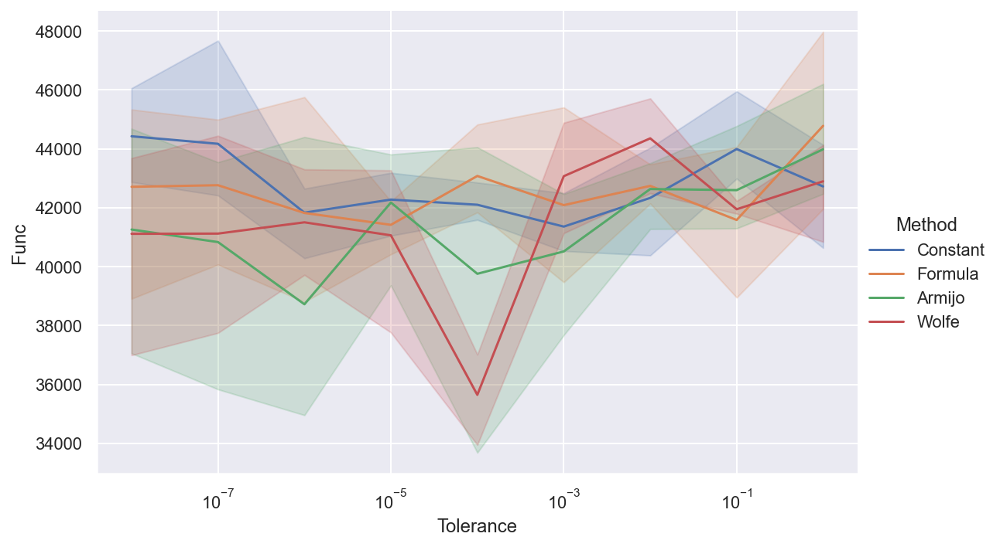

In [3]:
plt.figure(figsize=(8, 5))
methods = ['Constant', 'Formula', 'Armijo', 'Wolfe']
tolerances = np.logspace(0, -8, num=9)
df_func = pd.DataFrame(columns=['Method', 'Tolerance', 'Func'])
df_conv_fail = pd.DataFrame(columns=['Method', 'Tolerance', 'Failures perc'])
df_comp_fail = pd.DataFrame(columns=['Method', 'Tolerance', 'Failures perc'])
experiments = 3
col_name = "H1"
for method in methods:
    for tolerance in tolerances:
        for experiment in range(experiments):
            conv_failure = 0
            comp_failure = 0
            print(f"method {method}, tolerance {tolerance}, column {col_name}")
            model = DynamicRegression(fh=5, tolerance=tolerance)
            try:
                status, history = model.fit(dataset[col_name].dropna(), trace=True, lr_finder=method)
            except:
                status = 'computational_error'
            if status == 'computational_error':
                comp_failure = 1
            else:
                df_func.loc[len(df_func)] = [method, tolerance, history['func'][-1]]
            if status == 'iterations_exceeded':
                conv_failure = 1
            df_conv_fail.loc[len(df_conv_fail)] = [method, tolerance, conv_failure]
            df_comp_fail.loc[len(df_comp_fail)] = [method, tolerance, comp_failure]
g = sns.relplot(data=df_func, x='Tolerance', y='Func', hue='Method', kind='line', height=5, aspect=1.6)
g.set(xscale="log")
for ax in g.axes:
    ax.invert_xaxis()
g.set(title="Loss function depending on tolerance for different optimization methods")
plt.close('all')

AttributeError: 'numpy.ndarray' object has no attribute 'invert_xaxis'

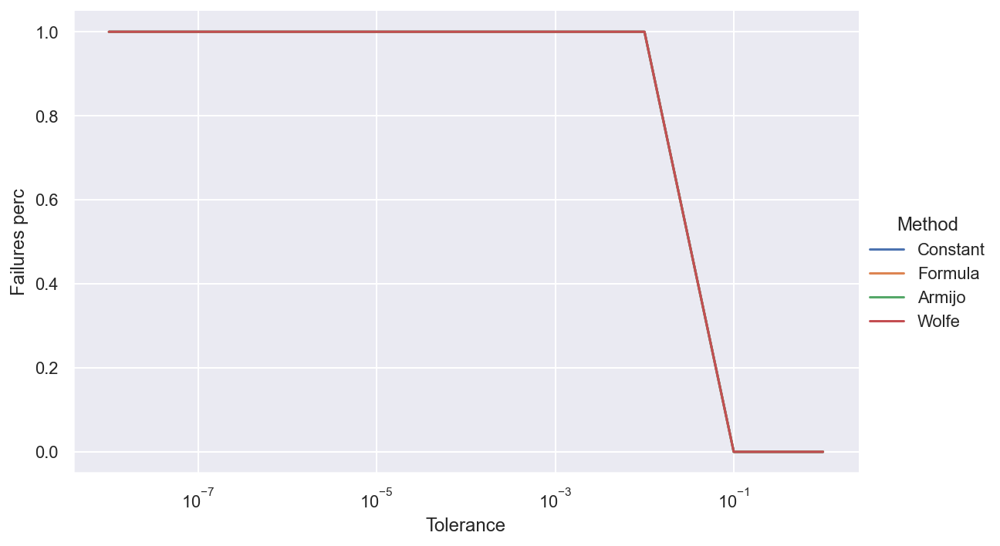

In [4]:
g = sns.relplot(data=df_conv_fail, x='Tolerance', y='Failures perc', hue='Method', kind='line', height=5, aspect=1.6)
g.set(xscale="log")
for ax in g.axes:
    ax.invert_xaxis()
g.set(title="Converge failures percentage depending on tolerance for different optimization methods")
plt.close('all')

AttributeError: 'numpy.ndarray' object has no attribute 'invert_xaxis'

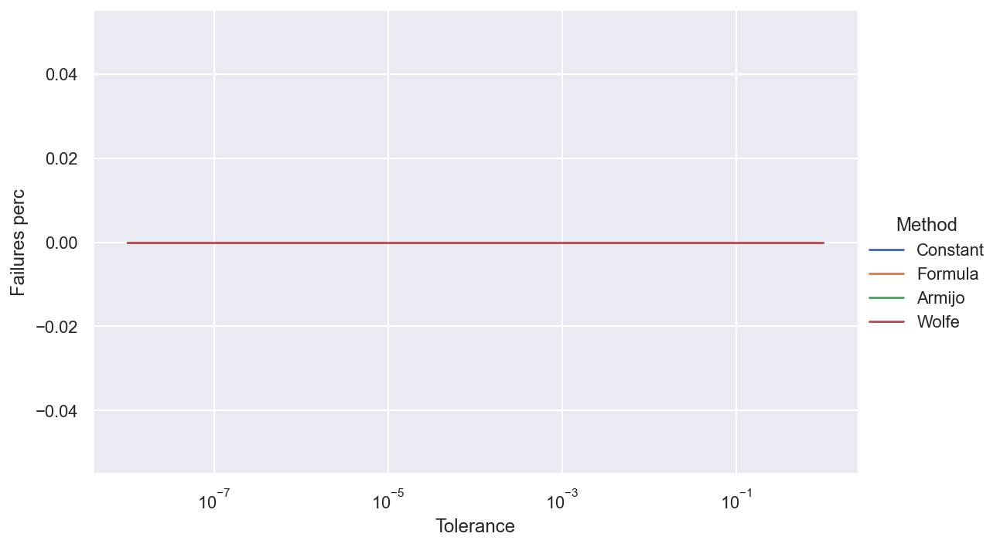

In [5]:
g = sns.relplot(data=df_comp_fail, x='Tolerance', y='Failures perc', hue='Method', kind='line', height=5, aspect=1.6)
g.set(xscale="log")
for ax in g.axes:
    ax.invert_xaxis()
g.set(title="Computational failures percentage depending on tolerance for different optimization methods")
plt.close('all')